In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import statistics
import scipy
from scipy import signal

# Vaccine sentiment visualization

In [2]:
vaccine_tweets = pd.read_csv("../data/processed/vaccine_tweets_with_sentiment.csv", index_col=0, converters={'hashtags': eval, 'sentiment':eval})
vaccination_progress = pd.read_csv("../data/external/country_vaccinations.csv")
vaccination_progress_by_manufacturer = pd.read_csv("../data/external/country_vaccinations_by_manufacturer.csv")

In [3]:
vaccine_tweets.head()

,id,created_at,user,geo,full_text,hashtags,user_id,PfizerBiontech,SputnikV,Sinopharm,Sinovac,Moderna,AstraZeneca,Covaxin,JandJ,user_location,coordinates,corpus,sentiment,sentiment_compound
0,1382113874439192576,2021-04-13 23:30:00+00:00,"{'id': 758414676480946200, 'id_str': '75841467...",NaN,"""Safe and Effective, Safe and Effective, Safe ...","[mrna, covidvaccine, johnsonandjohnson, pfizer...",758414676480946200,1,0,0,1,1,1,0,1,NaN,NaN,safe effective safe effective safe effective s...,"{'neg': 0.0, 'neu': 0.091, 'pos': 0.909, 'comp...",0.9953
1,1362299993504145408,2021-02-18 07:16:43+00:00,"{'id': 160763636, 'id_str': '160763636', 'name...",NaN,Hey dear friends my #COVAXIN is done and feel ...,"[covaxin, covid19, vaccinemaitri]",160763636,0,0,0,0,0,0,1,0,India,"[22.3511148, 78.6677428]",hey dear friend covaxin done feel good thanks ...,"{'neg': 0.0, 'neu': 0.311, 'pos': 0.689, 'comp...",0.9876
2,1375483502616010752,2021-03-26 16:23:16+00:00,"{'id': 1356008062620991500, 'id_str': '1356008...",NaN,We will be giving thousands of doses of the in...,"[oxfordastrazeneca, passover, covidjab]",1356008062620991500,0,0,0,0,0,1,0,0,NaN,NaN,giving thousand dos incredibly safe powerfully...,"{'neg': 0.0, 'neu': 0.282, 'pos': 0.718, 'comp...",0.9842
3,1367114490890752000,2021-03-03 14:07:49+00:00,"{'id': 143025857, 'id_str': '143025857', 'name...",NaN,Better efficacy than Oxford/covishield's 62%. ...,[covaxin],143025857,0,0,0,0,0,0,1,0,NaN,NaN,better efficacy oxford covishield best inactiv...,"{'neg': 0.0, 'neu': 0.325, 'pos': 0.675, 'comp...",0.9837
4,1395429383582724096,2021-05-20 17:21:05+00:00,"{'id': 19386982, 'id_str': '19386982', 'name':...",NaN,Huge thank you to the wonderful @HSELive staff...,[moderna],19386982,0,0,0,0,1,0,0,0,NaN,NaN,huge thank wonderful staff race got cancellati...,"{'neg': 0.0, 'neu': 0.295, 'pos': 0.705, 'comp...",0.9813


In [4]:
vaccination_progress_by_manufacturer = vaccination_progress_by_manufacturer.groupby(["vaccine","date"])["total_vaccinations"].sum().reset_index()

---

# Amount of vaccine mentions

In [5]:
fig = px.pie(vaccine_tweets,
             values=[
                 vaccine_tweets.PfizerBiontech.sum(),
                 vaccine_tweets.SputnikV.sum(),
                 vaccine_tweets.Sinopharm.sum(),
                 vaccine_tweets.Sinovac.sum(),
                 vaccine_tweets.Moderna.sum(),
                 vaccine_tweets.AstraZeneca.sum(),
                 vaccine_tweets.Covaxin.sum(),
                 vaccine_tweets.JandJ.sum()
                    ],
             names=[
                 "PfizerBiontech",
                 "SputnikV",
                 "Sinopharm",
                 "Sinovac",
                 "Moderna",
                 "AstraZeneca",
                 "Covaxin",
                 "JandJ"
                   ],
             title='Total Vaccine Mentions')
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.write_html("../reports/figures/VaccineSentiment/Vaccine_Mentions.html")

fig.show()

**The most talked about vaccine is BharatBiontechs Covaxin, followed by Moderna and PfizerBiontech.**

___

# Vaccines by daily tweet volume

extract date from timestamp and count the occurrence per day:

In [6]:
vaccine_tweets_temp = vaccine_tweets.copy()
vaccine_tweets_temp["created_at"] = pd.to_datetime(vaccine_tweets["created_at"]).dt.strftime('%Y-%m-%d')
vaccine_tweets_temp["count"] = 1

In [7]:
 vaccine_tweets_temp = vaccine_tweets_temp[["created_at", "PfizerBiontech", "SputnikV", "Sinopharm", "Sinovac", "Moderna", "AstraZeneca", "Covaxin", "JandJ","count"]]

In [8]:
vaccine_tweets_temp_count = vaccine_tweets_temp.groupby(["created_at"])["PfizerBiontech", "SputnikV", "Sinopharm", "Sinovac", "Moderna", "AstraZeneca", "Covaxin", "JandJ"].sum()

<ipython-input-8-7a292a2c6dc0>:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [9]:
vaccine_tweets_temp_count = vaccine_tweets_temp_count.reset_index(drop = False)

Change the list, so that all vaccines are in a column:

In [10]:
vax_tweets = pd.DataFrame(columns=["created_at","Vaccine","TweetAmount"])

for i in range(len(vaccine_tweets_temp_count)):
    for column in (vaccine_tweets_temp_count.columns[1:]):
        vax_tweets.loc[len(vax_tweets)+1] = [vaccine_tweets_temp_count["created_at"][i], column, vaccine_tweets_temp_count[column][i]]

In [11]:
fig = px.bar(vax_tweets, x="Vaccine", y="TweetAmount",\
             animation_frame=vax_tweets.created_at, range_y=[0,800],\
             title="Tweet Volume by day")
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 20 #animation speed
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Tweet_Volume_Day.html")

**Tweet volume of each vaccine by day. Achieved by counting the amount of tweets containing a hashtag of a vaccine on said day.**

___

## Vaccines by absolute tweet volume

For the absolute volume, the vaccine tweet volume of each day is added to the subsequent day:

In [12]:
vax_tweets_2 = vaccine_tweets_temp_count.copy()

for column in vax_tweets_2.columns[1:]:
    for i in range(len(vax_tweets_2[column])-1):
        vax_tweets_2[column][i+1] = vax_tweets_2[column][i]+vax_tweets_2[column][i+1]

<ipython-input-12-67e0ac08173c>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Change list so vaccines are in a column:

In [13]:
vax_tweets_3 = pd.DataFrame(columns=["created_at","Vaccine","TweetAmount"])

for i in range(len(vax_tweets_2)):
    for column in (vax_tweets_2.columns):
        if column != "created_at":
            vax_tweets_3.loc[len(vax_tweets_3)+1] = [vax_tweets_2["created_at"][i], column, vax_tweets_2[column][i]]

In [14]:
fig = px.bar(vax_tweets_3, x="Vaccine", y="TweetAmount",\
             title="Tweet Volume Over Time",\
             animation_frame=vax_tweets.created_at, range_y=[0,45000])
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 20
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Tweet_Volume_All.html")

___

# Positive, negative and neutral sentiment

Split the sentiment three ways to generate discrete variables:
- any sentiment less than -0.33 is negative, above 0.33 is positive and anything in between is neutral

In [15]:
pos_sentiment = [sentiment for sentiment in vaccine_tweets["sentiment_compound"] if (sentiment >= 0.33)]
neg_sentiment = [sentiment for sentiment in vaccine_tweets["sentiment_compound"] if (sentiment <= - 0.33)]
neu_sentiment = [sentiment for sentiment in vaccine_tweets["sentiment_compound"] if (sentiment < 0.33 and sentiment > -0.33)]

In [16]:
fig = px.box(
    y=vaccine_tweets["sentiment_compound"],
    title = "Overall Sentiment",
    labels={"y":"Sentiment"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Sentiment_Boxplot.html")

**Sentiment is overall neutral with a positive tendency. There are however outliers reaching far negative sentiment**

In [17]:
fig = px.bar(
    x=["Positive", "Neutral", "Negative"],
    y=[len(pos_sentiment), len(neu_sentiment), len(neg_sentiment)],
    title="Amount of tweets by sentiment",
    labels={"x":"Sentiment","y":"Amount of tweets"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Sentiment_Amount.html")

**Most tweets are neutral. Positive tweets are almost double the negative tweets.**

Positive Tweet (Sentiment = 0.98):

In [18]:
vaccine_tweets[vaccine_tweets["id"]==1362299993504145408]["full_text"].iloc[0]

'Hey dear friends my #COVAXIN is done and feel good. Thanks so much india ð\x9f\x87®ð\x9f\x87³ and Indian scientists for your wonderful achievements. Feel proud as a Indian. Yes my government doing great work for our people. Thanks ð\x9f\x99\x8fð\x9f\x8f» ð\x9f\x87®ð\x9f\x87³ love â\x9d¤ï¸\x8f and respect #COVID19 #VaccineMaitri'

Neutral Tweet (Sentiment = 0):

In [19]:
vaccine_tweets[vaccine_tweets["id"]==1398159083543306240]["full_text"].iloc[0]

"If you've taken #Covaxin (Manipal Hospital, #Goa),  you can book your second slot based on the dates given in your provisional certificate. Slots till 5th June are currently open. https://t.co/OiSbzoZKkU"

Negative Tweet (Sentiment = -0.68):

In [20]:
vaccine_tweets[vaccine_tweets["id"]==1382615821210427392]["full_text"].iloc[0]

"The Gates of Hell &amp; 'Luciferase' https://t.co/qmZzbqMHra via @C_H_Industries #Pfizer #Yeadon #luciferase #vaccine #Moderna #BillGates #Gates"

___

# Average Sentiment by Vaccine

Split dataframe in order to get sentiment sentiment of each vaccine

In [21]:
pfizerBiontech_tweets = vaccine_tweets[vaccine_tweets["PfizerBiontech"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
sputnikV_tweets = vaccine_tweets[vaccine_tweets["SputnikV"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
sinopharm_tweets = vaccine_tweets[vaccine_tweets["Sinopharm"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
sinovac_tweets = vaccine_tweets[vaccine_tweets["Sinovac"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
moderna_tweets = vaccine_tweets[vaccine_tweets["Moderna"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
astraZeneca_tweets = vaccine_tweets[vaccine_tweets["AstraZeneca"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
covaxin_tweets = vaccine_tweets[vaccine_tweets["Covaxin"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
jandj_tweets = vaccine_tweets[vaccine_tweets["JandJ"] == 1][["created_at","sentiment_compound"]].set_index("created_at")

In [22]:
pfizerBiontech_avg_sentiment = pfizerBiontech_tweets["sentiment_compound"].mean()
sputnikV_avg_sentiment = sputnikV_tweets["sentiment_compound"].mean()
sinopharm_avg_sentiment = sinopharm_tweets["sentiment_compound"].mean()
sinovac_avg_sentiment = sinovac_tweets["sentiment_compound"].mean()
moderna_avg_sentiment = moderna_tweets["sentiment_compound"].mean()
astraZeneca_avg_sentiment = astraZeneca_tweets["sentiment_compound"].mean()
covaxin_avg_sentiment = covaxin_tweets["sentiment_compound"].mean()
jandj_avg_sentiment = jandj_tweets["sentiment_compound"].mean()

In [23]:
fig = px.bar(
    x=["PfizerBiontech", "SputnikV", "Sinopharm", "Sinovac", "Moderna", "AstraZeneca", "Covaxin", "JandJ"],
    y=[pfizerBiontech_avg_sentiment, sputnikV_avg_sentiment, sinopharm_avg_sentiment, sinovac_avg_sentiment, moderna_avg_sentiment, astraZeneca_avg_sentiment, covaxin_avg_sentiment, jandj_avg_sentiment],
    title="Mean sentiment by Vaccine",
    labels={"x":"Vaccine","y":"Mean sentiment"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Mean_Vaccine_Sentiment.html")

**The sentiment of e.g. JandJ and SputnikV are questionable because the overall tweet volume of these two weren't high, so a few people can influence the sentiment big time**

In [24]:
fig = px.box(
    y=pfizerBiontech_tweets["sentiment_compound"],
    points="suspectedoutliers",
    title = "Overall Sentiment for PfizerBiontech",
    labels={"y":"Sentiment"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Overall_Sentiment_PfizerBiontech.html")

___

# Vaccine sentiment over time

Merge the vaccine dataframes together (outer join by "created_at"):

In [25]:
merged_vaccine_tweets = pd.merge(pfizerBiontech_tweets, sputnikV_tweets, left_index=True, right_index=True, how='outer')\
.merge(sinopharm_tweets, left_index=True, right_index=True, how="outer")\
.merge(sinovac_tweets, left_index=True, right_index=True, how="outer")\
.merge(moderna_tweets, left_index=True, right_index=True, how="outer")\
.merge(astraZeneca_tweets, left_index=True, right_index=True, how="outer")\
.merge(covaxin_tweets, left_index=True, right_index=True, how="outer")\
.merge(jandj_tweets, left_index=True, right_index=True, how="outer")

In [26]:
merged_vaccine_tweets.columns = ["PfizerBiontech","SputnikV","Sinopharm","Sinovac","Moderna","AstraZeneca","Covaxin","JandJ"]

Compare vaccine progress data to vaccine sentiment:

In [27]:
vaccination_progress_by_manufacturer[vaccination_progress_by_manufacturer["vaccine"] == "Johnson&Johnson"]

,vaccine,date,total_vaccinations
30,Johnson&Johnson,2020-12-27,0
31,Johnson&Johnson,2020-12-28,0
32,Johnson&Johnson,2020-12-29,0
33,Johnson&Johnson,2020-12-30,0
34,Johnson&Johnson,2020-12-31,0
...,...,...,...
212,Johnson&Johnson,2021-06-27,16448315
213,Johnson&Johnson,2021-06-28,16522666
214,Johnson&Johnson,2021-06-29,18555049
215,Johnson&Johnson,2021-06-30,16723354


In [28]:
total_vaccine_process = vaccination_progress.groupby(["date"])["total_vaccinations"].sum().reset_index()

In [29]:
total_vaccine_process

,date,total_vaccinations
0,2020-12-02,0.000000e+00
1,2020-12-03,0.000000e+00
2,2020-12-04,1.000000e+00
3,2020-12-05,0.000000e+00
4,2020-12-06,0.000000e+00
...,...,...
207,2021-06-27,2.910081e+09
208,2021-06-28,2.968104e+09
209,2021-06-29,2.990110e+09
210,2021-06-30,2.899115e+09


In [30]:
vaccination_progress_by_manufacturer["vaccine"].unique()[1:]

array(['Johnson&Johnson', 'Moderna', 'Oxford/AstraZeneca',
       'Pfizer/BioNTech', 'Sinopharm/Beijing', 'Sinovac', 'Sputnik V'],
      dtype=object)

Create a plot with a dropdown that includes all vaccines:
- the way this works is that you create many traces (think canvas)
- with a list containing boolean values, you can turn each trace on or off (becomes variable, depending on the selected button)
- the first set of traces (first for loop) plots the bar chart for the vaccine progress
- the second set of traces plots the sentiment over time
    - sentiment was smoothed through savitzky-golay filter

In [31]:
def sentiment_over_time(dataset):

    fig = go.Figure()
    
    for vaccine in vaccination_progress_by_manufacturer["vaccine"].unique()[1:]:
        fig.add_trace(
            go.Bar(
            x = vaccination_progress_by_manufacturer[vaccination_progress_by_manufacturer["vaccine"]==vaccine]["date"],
            y = vaccination_progress_by_manufacturer[vaccination_progress_by_manufacturer["vaccine"]==vaccine]["total_vaccinations"],
            yaxis='y1',
            name= vaccine + " doses",
            marker_color='orange'
            )
        )

    
    for column in dataset.columns.to_list():
        fig.add_trace(
            go.Line(
                x = dataset.sort_values("created_at")[column].dropna().index,
                y = signal.savgol_filter(
                    dataset.sort_values("created_at")[column].dropna(),
                    201,
                    4
                    ),
                yaxis = "y2",
                name = column + " senti."
            )
        )
        
    
    # Add dropdown
    fig.update_layout(
        updatemenus=[
            dict(
                buttons=list([
                    dict( 
                        args=[{'visible': [True,True,True,True,True,True,True,True,True,True,True,True,True,True,True]}, 
                               {'title' : '(Smoothed) Sentiment over time'}],
                        label="All",
                        method="update"
                    ),
                    dict( 
                        args=[{'visible': [False,False,False,True,False,False,False,True,False,False,False,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for PfizerBiontech'}],
                        label="PfizerBiontech",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,False,False,True,False,True,False,False,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for SputnikV'}],
                        label="SputnikV",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,True,False,False,False,False,True,False,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for Sinopharm'}],
                        label="Sinopharm",
                        method="update",
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,False,True,False,False,False,False,True,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for Sinovac'}],
                        label="Sinovac",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,True,False,False,False,False,False,False,False,False,False,True,False,False,False]}, 
                             {'title' : '(Smoothed) Sentiment over time for Moderna'}],
                        label="Moderna",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,True,False,False,False,False,False,False,False,False,False,True,False,False]}, 
                             {'title' : '(Smoothed) Sentiment over time for AstraZeneca'}],
                        label="AstraZeneca",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,False,False,False,False,False,False,False,False,False,True,False]},
                             {'title' : '(Smoothed) Sentiment over time for Covaxin'}],
                        label="Covaxin",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [True,False,False,False,False,False,False,False,False,False,False,False,False,False,True]},
                             {'title' : '(Smoothed) Sentiment over time for JandJ'}],
                        label="JandJ",
                        method="update"
                    )                    
                ]),
                direction="down",
                pad={"r": 10, "t": 10},
                showactive=True,
                x=1.0,
                xanchor="right",
                y=1.2,
                yanchor="top"
            ),
        ],
        xaxis_title="Time",
        legend_title="Vaccines"
    )
    
    fig.update(layout=go.Layout(yaxis1 = go.YAxis(title='Vaccination Progress', titlefont=go.Font(color='Orange'), side="right"),
                                yaxis2 = go.YAxis(title='Sentiment', titlefont=go.Font(color='Red'), overlaying='y', side="left")))
    
    fig.show()
    fig.write_html("../reports/figures/VaccineSentiment/Vaccine_Sentiment_Over_Time.html")

In [32]:
sentiment_over_time(merged_vaccine_tweets)

/opt/anaconda3/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.


/opt/anaconda3/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:322: DeprecationWarning:

plotly.graph_objs.Font is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Font
  - plotly.graph_objs.layout.hoverlabel.Font
  - etc.


/opt/anaconda3/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:572: DeprecationWarning:

plotly.graph_objs.YAxis is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.YAxis
  - plotly.graph_objs.layout.scene.YAxis




- **Vaccines used in predominantly in the U.S. have a dip on valentines and memorial day.**
- **A possible reason for the sentiment might be world news**
    - **for that we use google trends to determine what the most searched terms were at a given date**

___

## Google Trends analysis (w/ pytrends):

In [33]:
from pytrends.request import TrendReq

In [34]:
def getRisingTrends(query, time, qtype="rising"):
    pytrend = TrendReq()
    pytrend.build_payload(kw_list=[query], timeframe=time)
    print(pytrend.related_queries()[query][qtype])

### PfizerBiontech Search Queries:
- lowest: 16.01.

In [35]:
getRisingTrends("BioNTech", "2021-01-15 2021-01-17")

                          query   value
0  norwegen impfverbot biontech  115850


**Negative sentiment on 16. Jan is linked to norway stopping the use of Pfizer**

In [36]:
getRisingTrends("Pfizer", "2021-01-20 2021-01-22")

                                     query  value
0   pfizer vaccine side effects first dose   6100
1                           pfizer vakcina    200
2             where is pfizer vaccine made    200
3                    israel pfizer vaccine    120
4                             pfizer aktie    120
5                pfizer vs moderna vaccine    120
6                  pfizer vaccine efficacy     90
7               pfizer vaccine second dose     70
8                       pfizer stock price     60
9                       pfizer share price     50
10                            pfizer stock     40


**Possible explanation for the 21. Jan might be that the vaccine is working well, which made people interested in it's stock and even whether their country provides that vaccine**

In [37]:
getRisingTrends("Pfizer", '2021-05-23 2021-05-25')

                                  query  value
0                  pfizer vaccine dubai  21150
1                    myocarditis pfizer    600
2              reacciones vacuna pfizer    300
3   where to get pfizer vaccine near me    160
4                 pfizer vs astrazeneca    110
5                     moderna ou pfizer    110
6                             pfizer 疫苗    110
7                               sinovac     60
8                   astrazeneca vaccine     60
9               effet secondaire pfizer     60
10             pfizer vaccine melbourne     60
11     vacina pfizer efeitos colaterais     50
12                covid vaccine near me     50
13               pfizer side effects uk     40


**News about myocarditis might've lead to the negative sentiment that is observable on 24. May**

### Sinopharm/Sinovac Search Queries:
- highest: jun2

In [38]:
getRisingTrends("Sinovac", '2021-06-01 2021-06-03')

                             query  value
0                sinovac singapore  88600
1                sinovac impfstoff  59750
2   sinovac aşısı ne zaman gelecek  29700
3                         biontech   1400
4           biontech mi sinovac mi    650
5                   sinovac europa    450
6                   biontech aşısı    250
7             who approved sinovac    200
8                      oms sinovac    150
9             who sinovac approval    140
10                     sinovac who    130
11                   sinovac aşısı     90
12           sinovac efficacy rate     80
13                  vaksin sinovac     60
14                  วัคซีน sinovac     60


**Extremely positive sentiment on 2. Jun seems to be linked to the fact that the WHO approved of Sinovac/Sinopharm**

### AstraZeneca Search Queries:

In [39]:
getRisingTrends("AstraZeneca", "2021-03-14 2021-03-16")

                                   query  value
0                     biella astrazeneca  29800
1      paul ehrlich institut astrazeneca  16500
2                  paul ehrlich institut  14500
3         hirnvenenthrombose astrazeneca  13500
4               aifa astrazeneca sospeso  12950
5                 aussetzung astrazeneca   8450
6           ireland suspends astrazeneca   6650
7                   alemania astrazeneca   6600
8     does astrazeneca cause blood clots   4800
9   de qué país es la vacuna astrazeneca   3150
10             vacina astrazeneca origem   1650
11           astrazeneca vakcina poreklo   1550
12            astrazeneca vaccine banned    600
13               deutschland astrazeneca    600
14                astrazeneca ausgesetzt    600
15                     spahn astrazeneca    500
16                   ireland astrazeneca    500
17                  astrazeneca belgique    450
18           astrazeneca vaccine ireland    450
19                       ema astrazeneca

**On 15.Mar, it seems like the talk about astrazeneca causing thrombosis made the sentiment go down**

In [40]:
getRisingTrends("AstraZeneca", "2021-04-09 2021-04-11")

                             query  value
0     clarkson syndrom astrazeneca  16300
1    reações da vacina astrazeneca   4100
2   effets secondaires astrazeneca    140
3           astrazeneca 2. impfung    130
4     astrazeneca vaccine efficacy    110
5      vacina astrazeneca trombose    110
6       nebenwirkungen astrazeneca    100
7          szczepionka astrazeneca    100
8             eficacia astrazeneca     80
9        segunda dosis astrazeneca     70
10      astrazeneca vaccine canada     70
11                       comirnaty     60
12                    astra zenica     60
13          bugiardino astrazeneca     60
14           astrazeneca thrombose     40
15        bijwerkingen astrazeneca     40
16              vacina astrazeneca     40


**Successful ongoing vaccination campaigns might have lead to the  positive sentiment. Especially terms like "2. Impfung", "side effects of astrazeneca" hint that people are seriously considering the vaccine**

### Johnson & Johnson Search Queries:

In [41]:
getRisingTrends("Johnson and Johnson", time="2021-04-11 2021-04-13")

                                                query  value
0                                 blood clot symptoms  70900
1             johnson and johnson blood clot symptoms  65200
2     johnson and johnson vaccine blood clot symptoms  51900
3                   johnson and johnson vaccine pause  43800
4                johnson and johnson blood clot cases  39450
5                  johnson and johnson vaccine paused  22000
6          johnson and johnson vaccine blood clots us   8550
7                pause on johnson and johnson vaccine   8500
8   us calls for pause on johnson and johnson vaccine   4300
9                             fda johnson and johnson   1800
10                     johnson and johnson blood clot   1050
11                 johnson and johnson vaccine recall    850
12                                                cdc    350
13                         johnson and johnson recall    350
14                    fda johnson and johnson vaccine    300
15                      

**News about Johnson and Johnson causing blood clots caused an abrupt turn of sentiment. For the next step, we examin this sudden turn more in depth**

---

## Exploring the negative Press

Function to turn "sentiment_compound" into a discrete variable for a given vaccine. These discrete variables are then used to aggregate the volume of tweets by sentiment.

In [42]:
def tweetAmountBySentiment(dataset, vaccine):
    df = dataset[:].reset_index(drop=False)
    pos_tweets = df[df["sentiment_compound"] >= 0.33]
    pos_tweets["sentiment_compound"] = 1
    neg_tweets = df[df["sentiment_compound"] < -0.33]
    neg_tweets["sentiment_compound"] = -1
    neu_tweets = df[df["sentiment_compound"].between(-0.33,0.33)]
    neu_tweets["sentiment_compound"] = 0

    df = pd.merge(pos_tweets,neg_tweets, left_index=True, right_index=True, how='outer')\
                .merge(neu_tweets, left_index=True, right_index=True, how='outer')

    df.columns = ["created_at","Sentiment","created_at","Sentiment","created_at","Sentiment"]

    stacked_tweets = df.stack()
    df = stacked_tweets.unstack()
    df.reset_index(inplace = True, drop = True)
    
    df["created_at"] = pd.to_datetime(df["created_at"]).dt.strftime('%Y-%m-%d')
    df["count"] = 1
    
    temp_count = df.groupby(['created_at', 'Sentiment'])["count"].count().reset_index()
    df = pd.pivot_table(temp_count, index='created_at',columns='Sentiment',values='count',aggfunc=np.sum, fill_value=0)
    
    fig = go.Figure()

    for column in df.columns.to_list():
        fig.add_trace(
            go.Line(
                x = df.sort_values("created_at")[column].dropna().index,
                y = df.sort_values("created_at")[column].dropna(),
                name = column
            )
        )

    fig.update_layout(title = f"Amount of {vaccine} related tweets regarding (by Sentiment)")


    fig.show()
    fig.write_html("../reports/figures/VaccineSentiment/Tweet_Amount_By_Sentiment.html")

In [43]:
tweetAmountBySentiment(jandj_tweets, "JandJ")

<ipython-input-42-3bc616bc8e39>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-3bc616bc8e39>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-3bc616bc8e39>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda3/lib/python

**This highlights the shift in volume from positive to rather neutral with a negative trend on 15. Apr**

# Wordcloud

Generate a wordcloud to get an overall idea what words are used/ common in the Dataset:

In [44]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def generate_wordcloud(data, title=""):
    text = " ".join(t for t in data.dropna())
    stopwords = ["amp", "covid vaccine", "vaccine","vaccination","covid vaccination","covid","india"]
    wordcloud = WordCloud(stopwords = stopwords, scale=4, max_font_size=50, max_words=200,background_color="white").generate(text)
    fig = plt.figure(1, figsize=(16,16))
    plt.axis('off')
    fig.suptitle(title, fontsize=20)
    fig.subplots_adjust(top=2.3)
    plt.imshow(wordcloud, interpolation='bilinear')

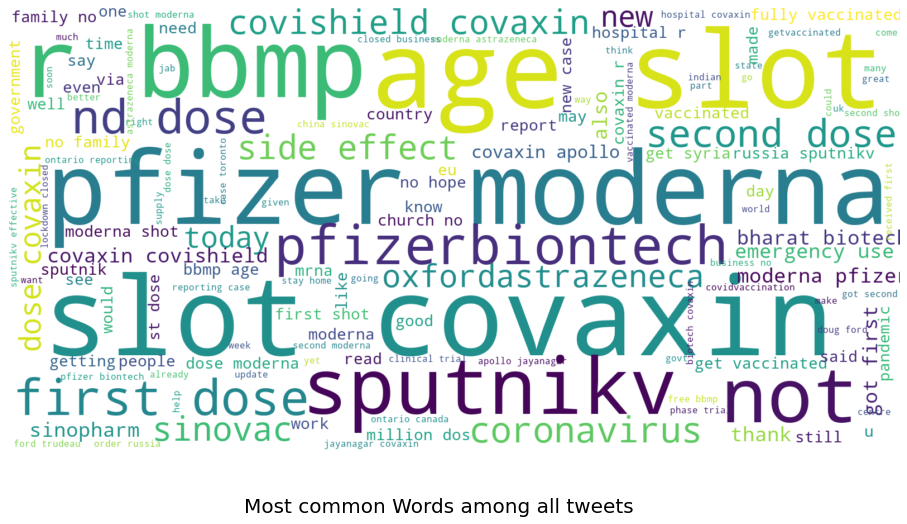

In [45]:
generate_wordcloud(vaccine_tweets["corpus"], "Most common Words among all tweets")

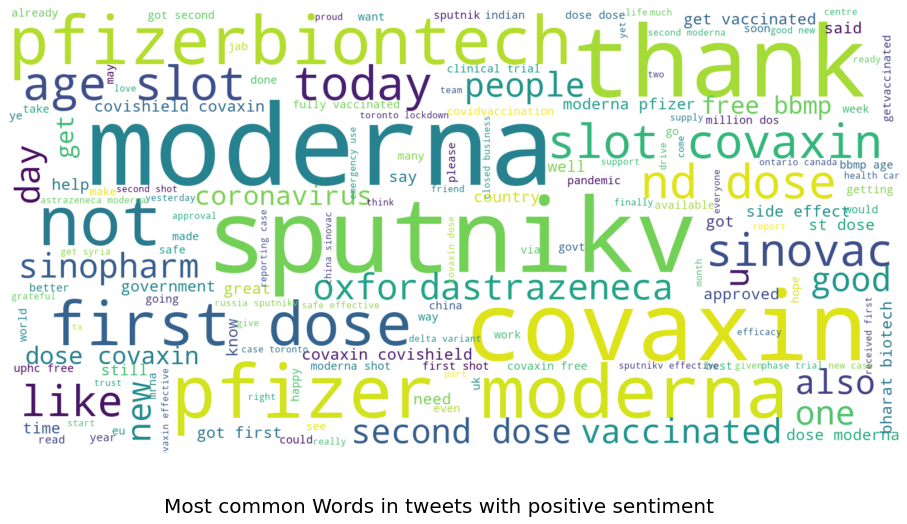

In [46]:
generate_wordcloud(vaccine_tweets["corpus"][vaccine_tweets["sentiment_compound"] >= 0.33], "Most common Words in tweets with positive sentiment")

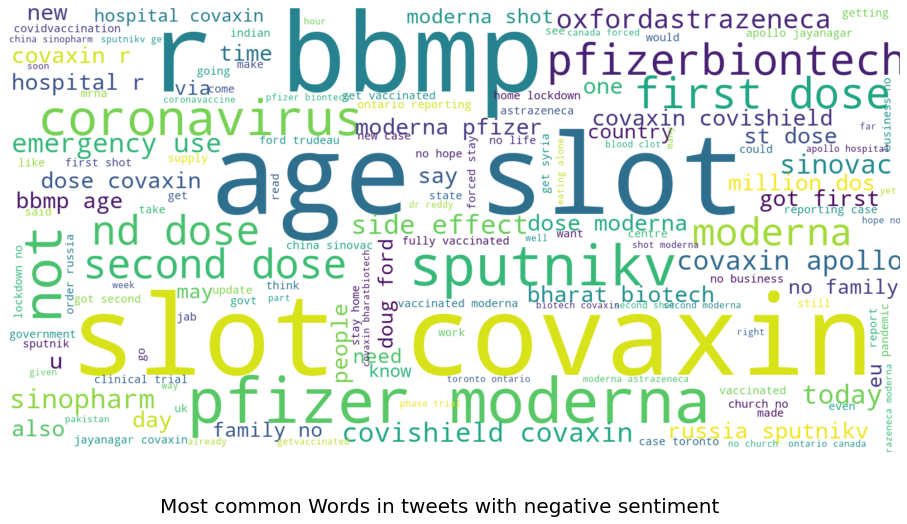

In [47]:
generate_wordcloud(vaccine_tweets["corpus"][vaccine_tweets["sentiment_compound"] <= 0.33], "Most common Words in tweets with negative sentiment")

**For further text analysis, check 06_AM_NLP_Anlaysis**